# Topic modeling of Austrian Reddit posts using BERTopic

This notebook `*` demonstrates the use of BERTopic, a topic modeling technique leveraging BERT embeddings, to analyze Reddit posts related to Austria. It covers data preprocessing, topic extraction, and visualization of topic distributions over time and in lower-dimensional spaces. The analysis aims to uncover key themes and trends in the Reddit dataset, providing insights into public discourse.

Topic modeling is an established method in the field of quantitative natural language processing, which has recently been experiencing a revival thanks to the popularity of large language models. It is a form of statistical learning that uses unsupervised learning methods to identify clusters of main keywords present within documents. These documents can be longer texts such as books, meeting notes, reports, etc., or shorter ones in the form of posts from social networks and other online platforms, as is the case in our example.

`*` I gratefully acknowledge Dr. Biljana Mileva Boshkoska for providing the original template (including the *austria_all_posts_and_comments_5_months_2024.pcl* file) on which this notebook is based.

## Inspecting and cleaning the data

We start of by loading our data that consists of comments posted on Austrian subreddit. The data spans a period of roughly five months from 2024, that includes the period of the European Parliament elections that were held across the EU from 6th to 9th of June. Our task will be to gain insight and interpret the main themes discussed in the comments via topic modeling with BERTopic. 

In [ ]:
import pandas as pd
from bertopic import BERTopic
import numpy as np
from sklearn.feature_extraction.text import CountVectorizer
from nltk.corpus import stopwords
import matplotlib.pyplot as plt

filename = './data/austria_all_posts_and_comments_5_months_2024.pcl'
df =  pd.read_pickle(filename)

# Ensure the Timestamp column is in datetime format.
df['Timestamp'] = pd.to_datetime(df['Timestamp'])

# Find the minimum and maximum timestamps.
min_time = df['Timestamp'].min()
max_time = df['Timestamp'].max()

# Calculate the time span.
time_span = max_time - min_time

print(f"First Entry: {min_time}")
print(f"Last Entry: {max_time}")
print(f"Time Span: {time_span}")


First Entry: 2024-04-01 02:12:03
Last Entry: 2024-08-30 23:33:56
Time Span: 151 days 21:21:53


In [221]:
df.head()

,Comment ID,Author,Comment,Timestamp
24576,l49yp8h,Fabiennethefemboy,Des schnizl mit zimt,2024-05-16 07:40:47
24577,l49yp8h,Fabiennethefemboy,Des schnizl mit zimt,2024-05-16 07:40:47
25395,lbeoilk,Rufus_L,Würde heute Österreich wieder gegen die Türkei...,2024-07-03 06:47:49
25396,lbeoilk,Rufus_L,Würde heute Österreich wieder gegen die Türkei...,2024-07-03 06:47:49
25397,lbenkyk,HumbleGarbage1795,"Wir waren Favorit und hatten mehr vom Spiel, h...",2024-07-03 06:37:42


The text is mostly written in Austrian German (because of practical concerns we will refer to the language as German from now on, taking into consideration also the modeling pipelines used, that are mostly based on Standard German). We can also immediately spot duplicates, so we remove them and additionaly apply other standard preprocessing steps to clean our data.

In [222]:
# Saving nr. of rows for later comparisons.
length_df_before_preprocessing = len(df)

# Geting rid of duplicates
df = df.drop_duplicates()

In [223]:
# Getting rid of empty comments and the ones that were removed or deleted by the administrators
# of the site. 
wh = df['Comment'] == '[removed]'
wh1 = df['Comment'] == '[deleted]'
wh2 = df['Comment'].isnull()

# Keep only valid comments by applying the filters.
df = df.loc[~(wh | wh1 | wh2), :]

In [224]:
df['Comment']

24576                                  Des schnizl mit zimt
25395     Würde heute Österreich wieder gegen die Türkei...
25397     Wir waren Favorit und hatten mehr vom Spiel, h...
25399     Ok. Es gibt meistens einen Favoriten bei einem...
25401     Wir **waren** klarer Favorit. Weiß ned wie man...
                                ...                        
454408    Was für ein Rachefeldzug? Der Afghanistankrieg...
454410    „Nicht furchtbar nachhaltig“ ist ein wahnsinni...
454412    ...Der Einsatz ist keine friedenssichernde Bla...
454414    Ah, und du meinst der UN-Sicherheitsrat, in de...
454416    Ah, und du meinst China und Russland hätten Pr...
Name: Comment, Length: 54136, dtype: object

In [225]:
#Since we would like to have a nicer view of the comments section we use the dtale package for interactive rendering of a pandas df.
import dtale

d = dtale.show(df)
d.open_browser()

In [226]:
# Creating a backup of the original comments.
df['Comment_Original'] = df['Comment']

In [227]:
# Removing emojis.
import emoji

def remove_emojis(text):
    return emoji.replace_emoji(text, replace='')

In [228]:
# Removing hyperlinks.
import re

def replace_hyperlinks(text, replace=''):
    # Regex pattern to match hyperlinks (including http/https)
    url_pattern = r'https?://\S+|www\.\S+'
    return re.sub(url_pattern, replace, text)

In [229]:
# Lowercasing the text.
df['Comment'] = (
    df['Comment']
    .apply(remove_emojis)
    .apply(replace_hyperlinks)
    .str.lower()
)

In [230]:
df = df.reset_index(drop=True)
df

,Comment ID,Author,Comment,Timestamp,Comment_Original
0,l49yp8h,Fabiennethefemboy,des schnizl mit zimt,2024-05-16 07:40:47,Des schnizl mit zimt
1,lbeoilk,Rufus_L,würde heute österreich wieder gegen die türkei...,2024-07-03 06:47:49,Würde heute Österreich wieder gegen die Türkei...
2,lbenkyk,HumbleGarbage1795,"wir waren favorit und hatten mehr vom spiel, h...",2024-07-03 06:37:42,"Wir waren Favorit und hatten mehr vom Spiel, h..."
3,lbep2p3,Xeppl,ok. es gibt meistens einen favoriten bei einem...,2024-07-03 06:53:56,Ok. Es gibt meistens einen Favoriten bei einem...
4,lbeod99,stupid_prices,wir **waren** klarer favorit. weiß ned wie man...,2024-07-03 06:46:11,Wir **waren** klarer Favorit. Weiß ned wie man...
...,...,...,...,...,...
54131,l30tjan,bajou98,was für ein rachefeldzug? der afghanistankrieg...,2024-05-07 19:16:00,Was für ein Rachefeldzug? Der Afghanistankrieg...
54132,l2yv1yk,Dekagramsci,„nicht furchtbar nachhaltig“ ist ein wahnsinni...,2024-05-07 12:00:03,„Nicht furchtbar nachhaltig“ ist ein wahnsinni...
54133,l370ecn,distroia_man,...der einsatz ist keine friedenssichernde bla...,2024-05-08 21:50:49,...Der Einsatz ist keine friedenssichernde Bla...
54134,l37709p,bajou98,"ah, und du meinst der un-sicherheitsrat, in de...",2024-05-08 22:31:58,"Ah, und du meinst der UN-Sicherheitsrat, in de..."


In [231]:
# Matching all text with square brackets.
pattern = r'\[.*?\]'

rows_with_brackets = df[df['Comment'].str.contains(pattern, regex=True, na=False)]

print(rows_with_brackets)

      Comment ID             Author  \
107      lbf64cm         LarryIDura   
158      la8q1ra         unixviking   
183      la8s7va       _KeyserSoeze   
249      lachwos                _ak   
282      laccmg9      AutoModerator   
...          ...                ...   
53731    kyg5x8v                NaN   
53864    l2z5atu             wuzman   
54041    l2yoyw0  DonaldChavezToday   
54081    l2ytitu        wegwerferie   
54114    l2ys7xb        Dekagramsci   

                                                 Comment           Timestamp  \
107    österreich ist nicht nur überall favorit sonde... 2024-07-03 10:13:16   
158    ich hab ja schon cordoba erlebt, aber das ich ... 2024-06-25 18:15:45   
183    fick die henne war das ein geiles match! jetzt... 2024-06-25 18:27:34   
249                ![gif](giphy|rfm7e9lhhrfhg|downsized) 2024-06-26 11:16:28   
282    bitte verwende keine url shortener wie bit.ly ... 2024-06-26 10:25:24   
...                                                

In [232]:
#Example of problematic entry.
print(df['Comment'].iloc[249])

df = df.drop(249)

![gif](giphy|rfm7e9lhhrfhg|downsized)


In [233]:
df['Comment'].iloc[249]

'dafür wirds umso schmerzhafter wenn wir gegen einen vermeintlich schwächeren gegner rausfliegen'

In [234]:
# Dropping empy rows.
df = df.dropna()

In [235]:
# Extract all bracketed texts and flatten them into a list.
bracketed_texts = rows_with_brackets['Comment'].str.findall(pattern).explode()

# Get unique bracketed texts.
unique_bracketed_texts = bracketed_texts.dropna().unique()

print("Unique bracketed texts:")
for text in unique_bracketed_texts:
    print(text)

Unique bracketed texts:
[img]
[gif]
[hier nachlesen]
[how-to here]
[contact the moderators of this subreddit]
[...]
[hier]
[sokka-haiku]
[ef-epi-2023-english]
[sexuelle belästigung am arbeitsplatz ak]
[derweil]
[zum beispiel]
[pressestunde]
[gefangenendilemma]
[sogar bis zur hauptstadt der ukraine]
[500.000 tote und verwundete]
[5 jahre habe ich auf eine fortsetzung gewartet, my life is complete]
[r/virginityexchange]
[this is how my great grandpa stored his dynomite, passed away, and left me to deal with it christmas eve]
[final update: this is how my great grandpa stored his dynomite]
[okappearance2976]
[5 days]
[**2024-08-11 07:55:28 utc**]
[**this link**]
[**57 others clicked this link**]
[^(delete this message to hide from others.)]
[^(info)]
[nicht sprengbares gut]
[**2027-04-10 00:00:00 utc**]
[**click this link**]
[learn&#32;more&#32;about&#32;me.]
[stichwort millionenshow]
[direkt aus dem gesetzestext §7a ]
[heute artikel]
[google link]
[3 gsatzln]
[...\]
[allen anderen progra

In [236]:
len(unique_bracketed_texts)

625

We can see that there is quite a lot of bracketed text in our data. We choose the tactic of saving all the unique ones to a CSV file and manually determine which ones we'll add to our list of stopwords below.

In [237]:
unique_bracketed_texts_df = pd.DataFrame(unique_bracketed_texts, columns=['bracketed_text'])
unique_bracketed_texts_df.to_csv('./artifacts/bracketed_texts.csv', index=False)

In [238]:
bracketed_texts_selection = pd.read_csv('./artifacts/bracketed_texts(selection).csv')['bracketed_text'].tolist()
print(len(bracketed_texts_selection))
print(bracketed_texts_selection)

130
['[how-to here]', '[contact the moderators of this subreddit]', '[...]', '[hier]', '[**2024-08-11 07:55:28 utc**]', '[**this link**]', '[**57 others clicked this link**]', '[^(delete this message to hide from others.)]', '[^(info)]', '[**2027-04-10 00:00:00 utc**]', '[**click this link**]', '[learn&#32;more&#32;about&#32;me.]', '[...\\]', '[^(why & about)]', '[**2029-08-12 18:32:26 utc**]', '[link zu download]', '[stift melk 3d-modell]', '[**2049-07-16 06:35:56 utc**]', '[**2024-06-11 05:34:21 utc**]', '[**1 others clicked this link**]', '[link]', '[/s]', '[import]', '[**2024-08-21 15:26:12 utc**]', '[]', '[andy84.]', '[…]', '[**2024-07-29 17:16:51 utc**]', '[^(optout)]', '[^(original github)]', '[….]', '[virus]', '[orf.at]', '[artikel 58]', '[artikel 44]', '[**2024-07-16 09:23:42 utc**]', '[**4 others clicked this link**]', '[**2024-07-09 09:11:36 utc**]', '[**132 others clicked this link**]', '[11]', '[18]', '[radio.garden]', '[radiobollerwagen.de]', '[lounge.fm]', '[pdf]', '[fw]

We continue cleaning comments by defining a list of stopwords. These represent words that are most common in a language (examples for English include "the", "and", "is") and thus don't add much value to the analysis. We additionaly add to the stopwords list words that wouldn't be classified as stopwords per se, but don't carry enough meaning in the specific context of our data that they appear in. This way we remove some noise from our data and reduce the size of the vocabulary, which is welcome in terms of optimizing performance and memory usage. Most importantly, this way we let our application focus on the parts of text that carry with it more meaning. Later on our model will be more easily able to highlight the terms and topics in the text that are key to understanding it.

In [239]:
# Define the stop words of the German language.
language = 'german'
german_stopwords = stopwords.words(language)

additional_stopwords = pd.read_excel('./stopwords/Reddit_Austria_stopwords.xlsx')
additional_stopwords = additional_stopwords.to_numpy().tolist()

for i in range(0,len(additional_stopwords)):
    german_stopwords.append(additional_stopwords[i][0])

# Adding additional stopwords at the end, after manually inspecting the data.
german_stopwords.extend([
    '[delete]', 
    'deleted', 
    '[removed]', 
    'removed', 
    'ja', 
    '100', 
    '120', 
    '130', 
    '140', 
    '>',
    ':)',
    ';)',
    '[gif]',
    '<3',
    ':-)',
    '*lol*',
    ':/',
    '[img]',
    ':D',
    r'¯\\\_(ツ)\_/¯'
])

# We also add bracketed text from before.
german_stopwords.extend(bracketed_texts_selection)

The actual removal of the stopwords is performed by a vectorizer model that preprocesses the text, before fiting the topic model. The vectorizer_model is responsible for tokenizing the text, removing stopwords and creating a document-term matrix (DTM - the rows correspond to the documents in the corpus, the columns to the terms/tokens in the documents, the values are the counts), which can then be used by BERTopic to identify topics.

The unigrams parameter is set to default (ngram_range=(1, 1)). This means only single words will be used as tokens. 
Since our data consists of short text in the form of comments we predict this would be a sufficient baseline setting 
(the presupposition here being that users tend to condense more meaning in relation to number of words used in this type of contexts).  

In [240]:
vectorizer_model = CountVectorizer(stop_words=german_stopwords, ngram_range=(1, 1))

In [243]:
# Checking the difference in nr. of rows before/after applying our preprocessing steps.
print(length_df_before_preprocessing - len(df))

# We make a copy of our original df for use later.
df_full = df.copy()

134265


## Creating two BERTopic models
### Main resources for this section:
### - https://maartengr.github.io/BERTopic/getting_started/multiaspect/multiaspect.html
### - https://maartengr.github.io/BERTopic/getting_started/representation/llm.html
### - https://newsletter.maartengrootendorst.com/p/topic-modeling-with-llama-2

We will split the dataset into two - one that will cover the time leading up to the newly elected parties and another that covers the time after the elections (since intermediate voting results are not disclosed to general public we decide to represent the election days from 6th to 7th of June as part of the first split).

In [245]:
df_before = df[df['Timestamp'] <= pd.Timestamp("2024-06-09")]
df_after = df[df['Timestamp'] > pd.Timestamp("2024-06-09")]

comments_before = df_before['Comment'].to_list()
comments_after = df_after["Comment"].to_list()

Llama2 7B (https://huggingface.co/meta-llama/Llama-2-7b-chat-hf) will be part ob our representation model. Since we'll be using it through Hugging Face we need to provide our HF token.

In [246]:
from huggingface_hub import notebook_login

notebook_login()

In [247]:
# Checking if CUDA is available to run inference locally.
from torch import cuda

model_id = "meta-llama/Llama-2-7b-chat-hf"
device = f'cuda:{cuda.current_device()}' if cuda.is_available() else 'cpu'
print(device)

cuda:0


In [ ]:
# Some parts like this are commented out, since running the cells
# multiple times was not in all cases sensible at the time of 
# preparing the notebook. Uncomment them when wanting to run the whole
# notebook by yourself.

# # Prepare quantization config.
# from torch import bfloat16
# import transformers

# bnb_config = transformers.BitsAndBytesConfig(
#     load_in_4bit=True,
#     bnb_4bit_quant_type='nf4',
#     bnb_4bit_use_double_quant=True,
#     bnb_4bit_compute_dtype=bfloat16
# )

In [28]:
# tokenizer = transformers.AutoTokenizer.from_pretrained(model_id)

# model = transformers.AutoModelForCausalLM.from_pretrained(
#     model_id,
#     trust_remote_code=True,
#     quantization_config=bnb_config,
#     device_map='auto'
# )
# model.eval()

In [29]:
# generator = transformers.pipeline(
#     model=model,
#     tokenizer=tokenizer,
#     task='text-generation',
#     temperature=0.1,
#     max_new_tokens=500,
#     repetition_penalty=1.1
# )

In [30]:
# # Testing our LLM.

# prompt = """
# Explain to me how 4-bit quantization works. The explanation should be suitable for a 10 year old.
# After providing the English version of the explanation also generate a German translation of your
# explanation.
# """

# res = generator(prompt)
# print(res[0]["generated_text"])

In order to get the results we want we'll need to perform some basic prompt engineering.

In [248]:
# Notice that in the prompt we have to specify to the model that the text is taken from Austrian and not German residents.
system_prompt = """
<s>[INST] <<SYS>>
You are a helpful, respectful and honest assistant for labeling topics. You provide the topics in English, from text that is mostly written in Austrian German (keep in mind that the authors of the texts are Austrians and not Germans!). 
<</SYS>>
"""

# Example prompt to demonstrate the kind of output we want.
# English translation of text in bullet points:
# - Traditional diets in most cultures were primarily plant-based with a little meat on top, but with the rise of industrial style meat production and factory farming, meat has become a staple food.
# - Meat, but especially beef, is the worst food in terms of emissions.
# - Eating meat doesn't make you a bad person, not eating meat doesn't make you a good one.
# ...and in keywords section: 'meat, beef, eat, eating, emissions, steak, food, health, processed, chicken'.
example_prompt = """
I have a topic that contains the following documents:
- Traditionelle Ernährungsweisen in den meisten Kulturen waren hauptsächlich pflanzenbasiert mit ein wenig Fleisch obendrauf, aber durch den Aufstieg der industriellen Fleischproduktion und Massentierhaltung ist Fleisch zu einem Grundnahrungsmittel geworden.
- Fleisch, insbesondere Rindfleisch, ist das schlechteste Lebensmittel in Bezug auf Emissionen.
- Fleisch zu essen macht dich nicht zu einer schlechten Person, und kein Fleisch zu essen macht dich nicht zu einer guten.

The topic is described by the following keywords: 'Fleisch, Rindfleisch, essen, Ernährung, Emissionen, Steak, Lebensmittel, Gesundheit, verarbeitet, Huhn'.

Based on the information about the topic above, please create a short label of this topic (in English). Make sure you to only return the label and nothing more.
[/INST] Environmental impacts of eating meat
"""

main_prompt = """
[INST]
I have a topic that contains the following documents:
[DOCUMENTS]

The topic is described by the following keywords: '[KEYWORDS]'.

Based on the information about the topic above, please create a short label of this topic (in English). Make sure you only return the label and nothing more.
[/INST]
"""

In [249]:
# Combine the prompts.
prompt = system_prompt + example_prompt + main_prompt

Our LLM model is working and we've set our prompts. Before we continue let's spend some time explaining the basic architecture of BERTopic to better understand where our LLM will fit in next to the other parts.

BERTopic extracts coherent topics out of text corpuses leveraging several components that complement each other. The central components are:

- Transformer-based language model (like BERT):

    Converts input documents into embeddings that capture the semantic meaning behind (usually sentence) chunked parts of text.

- Dimensionality reduction algorithm (e.g., UMAP):

    Makes clustering more effective by reducing the higher-dimensional embeddings to a lower-dimensional space.

- Clustering algorithm (e.g., HDBSCAN):

    Groups similar embeddings into clusters that represent the topics.

Each of these parts can be modified, but we'll use the defaults here. When the topics get extracted BERTopic offers a set of tools with which we can represent them.* Following the tutorial on https://newsletter.maartengrootendorst.com/p/topic-modeling-with-llama-2 we'll produce the representations using KeyBERT (extracts keywords from each cluster usine cosine similarity metric), MMR (also takes diversity of keywords into account) and Llama2 (generates descriptive phrases or sentences for each topic). The latter is the one we'll be focusing on.

*The quality of subsequent topic representations is also affected by the vectorization algorithm that is usually part of the topic model. Here we'll use CountVectorizer that we already initialized in one of the above cells. The document-term matrix it produces is used for generating a cluster-based TF-IDF representation of the topics (c-TF-IDF) which can be depicted standalone or act as a basis upon which the other representation methods build upon, which we do here.

In [250]:
# Load embedding model. Note we are using a model that is multilingual, supporting English, German, as well as over 40 other languages.
from sentence_transformers import SentenceTransformer

embedding_model = SentenceTransformer("sentence-transformers/distiluse-base-multilingual-cased-v2")

2025-01-24 18:44:04,490 - INFO     - Use pytorch device_name: cuda


2025-01-24 18:44:04,491 - INFO     - Load pretrained SentenceTransformer: sentence-transformers/distiluse-base-multilingual-cased-v2


In [34]:
# Precalculate the embeddings.
embeddings_before = embedding_model.encode(comments_before, show_progress_bar=True)

Batches:   0%|          | 0/655 [00:00<?, ?it/s]

In [35]:
from umap import UMAP
from hdbscan import HDBSCAN

umap_model = UMAP(
    n_neighbors=15,
    n_components=5,
    min_dist=0.0,
    metric='cosine',
    random_state=42
    )

In [36]:
hdbscan_model = HDBSCAN(
    min_cluster_size=150,
    metric='euclidean',
    cluster_selection_method='eom',
    prediction_data=True
)

In [37]:
reduced_embeddings_before = UMAP(
    n_neighbors=15,
    n_components=2,
    min_dist=0.0,
    metric='cosine',
    random_state=42
    ).fit_transform(embeddings_before)

In [38]:
import pickle

# # Saving the embeddings to a pickle file.
# with open("./artifacts/embeddings_before.pkl", "wb") as f:
#     pickle.dump(embeddings_before, f)

# # Saving the reduced embeddings.
# with open("./artifacts/reduced_embeddings_before.pkl", "wb") as f:
#     pickle.dump(reduced_embeddings_before, f)

In [39]:
# # Loading the embeddings and reduced embeddings
# with open("./artifacts/embeddings_before.pkl", "rb") as f:
#     embeddings_before = pickle.load(f)

# with open("./artifacts/reduced_embeddings_before.pkl", "rb") as f:
#     reduced_embeddings = pickle.load(f)

In [40]:
# Alternative implementation using llama.cpp. Further tweaks necessary to produce equal results
# to HF implementation.
# If used then in the representation models section below
# we need to define 'llama2 = LlamaCPP(llm)'

# # from llama_cpp import Llama
# from bertopic.representation import LlamaCPP

# llm = Llama(
#     model_path="llama-2-7b-32k-instruct.Q4_K_M.gguf", 
#     n_gpu_layers=999, # Nr. of layers to offload to GPU.
#     n_ctx=1024, # Context window length.
#     verbose=False,
#     stop="Q:" # Generation is set to stop at 'Q:' because 'Q:'/'A:' structure is used in default template. 
# )

In [41]:
# # Define representation models.

# from bertopic.representation import KeyBERTInspired, MaximalMarginalRelevance, TextGeneration

# keybert = KeyBERTInspired()

# mmr = MaximalMarginalRelevance(diversity=0.3)

# llama2 = TextGeneration(generator, prompt=prompt)

# representation_model = {
#     "KeyBERT": keybert,
#     "Llama2": llama2,
#     "MMR": mmr,
# }

In [42]:
# from bertopic import BERTopic

# topic_model_before = BERTopic(

#     # Sub-models.
#     vectorizer_model=vectorizer_model,
#     embedding_model=embedding_model,
#     umap_model=umap_model,
#     hdbscan_model=hdbscan_model,
#     representation_model=representation_model,

#     # Hyperparameters.
#     top_n_words=10,
#     verbose=True,
#     language='german',
#     calculate_probabilities=True,
# )

In [43]:
# # We train the model.
# topics, probs = topic_model_before.fit_transform(comments_before, embeddings_before)

In [44]:
# topic_model_before.get_topic_info()

In [45]:
# llama2_labels_before = [label[0][0].split("\n")[0] for label in topic_model_before.get_topics(full=True)["Llama2"].values()]

In [46]:
# llama2_labels_before

In [47]:
# topic_model_before.set_topic_labels(llama2_labels_before)

In [48]:
# topic_model_before.save("./artifacts/topic_model_before.pkl")

In [49]:
# # Loading the model.
# topic_model_before = BERTopic.load("./artifacts/topic_model_before.pkl")

## Visualizing the topics

### Main topics discussed on Reddit before EU parliament elections

In [50]:
# topic_model_before.visualize_documents(
#     comments_before,
#     reduced_embeddings=reduced_embeddings_before,
#     hide_annotations=True,
#     hide_document_hover=False,
#     custom_labels=True
# )

In [51]:
# datamap_before = topic_model_before.visualize_document_datamap(
#     comments_before,
#     reduced_embeddings=reduced_embeddings_before,
#     #hide_annotations=True,
#     #hide_document_hover=False,
#     custom_labels=True,
# )

In [52]:
# import itertools

# # Define colors for the visualization to iterate over.
# colors = itertools.cycle(['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4', '#46f0f0', '#f032e6', '#bcf60c', '#fabebe', '#008080', '#e6beff', '#9a6324', '#fffac8', '#800000', '#aaffc3', '#808000', '#ffd8b1', '#000075', '#808080', '#ffffff', '#000000'])
# color_key = {str(topic): next(colors) for topic in set(topic_model_before.topics_) if topic != -1}

In [53]:
# # Prepare dataframe and ignore outliers.
# df = pd.DataFrame({"x": reduced_embeddings_before[:, 0], "y": reduced_embeddings_before[:, 1], "Topic": [str(t) for t in topic_model_before.topics_]})
# df["Length"] = [len(doc) for doc in comments_before]
# df = df.loc[df.Topic != "-1"]
# df = df.loc[(df.y > -10) & (df.y < 10) & (df.x < 10) & (df.x > -10), :]
# df["Topic"] = df["Topic"].astype("category")

In [54]:
# # Get centroids of clusters.
# mean_df = df.groupby("Topic").mean().reset_index()
# mean_df.Topic = mean_df.Topic.astype(int)
# mean_df = mean_df.sort_values("Topic")

In [55]:
# import seaborn as sns
# from matplotlib import pyplot as plt
# from adjustText import adjust_text
# import matplotlib.patheffects as pe
# import textwrap

# # Plot using Seaborn with hue
# fig = plt.figure(figsize=(20, 20))
# sns.scatterplot(
#     data=df,
#     x='x',
#     y='y',
#     hue='Topic',  # Use hue instead of manually mapping colors
#     palette=color_key,  # Pass the color mapping as a palette
#     alpha=0.4,
#     size='Length',  # Adjust size based on Length
#     sizes=(10, 200)
# )

# # Limit the annotation to the top 20 topics (we have less in our case, so all of the topics are taken into account)
# texts, xs, ys = [], [], []
# for row in mean_df.iterrows():
#   topic = row[1]["Topic"]
#   name = textwrap.fill(topic_model_before.custom_labels_[int(topic)], 20)
#   if int(topic) <= 20:
#     xs.append(row[1]["x"])
#     ys.append(row[1]["y"])
#     texts.append(plt.text(row[1]["x"], row[1]["y"], name, size=10, ha="center", color=color_key[str(int(topic))],
#                           path_effects=[pe.withStroke(linewidth=0.5, foreground="black")]
#                           ))

# # Adjust annotations such that they do not overlap.
# adjust_text(texts, x=xs, y=ys, time_lim=1, force_text=(0.01, 0.02), force_static=(0.01, 0.02), force_pull=(0.5, 0.5))
# plt.axis('off')
# plt.legend('', frameon=False)
# plt.show()

### Main topics discussed on Reddit after EU parliament elections

In [113]:
embeddings_after = embedding_model.encode(comments_after, show_progress_bar=True)

Batches:   0%|          | 0/994 [00:00<?, ?it/s]

In [122]:
reduced_embeddings_after = UMAP(
    n_neighbors=15,
    n_components=2,
    min_dist=0.0,
    metric='cosine',
    random_state=42
    ).fit_transform(embeddings_after)

In [58]:
# # Saving the embeddings and reduced embeddings.
# with open("./artifacts/embeddings_after.pkl", "wb") as f:
#     pickle.dump(embeddings_after, f)

# with open("./artifacts/reduced_embeddings_after.pkl", "wb") as f:
#     pickle.dump(reduced_embeddings_after, f)

In [59]:
# # Loading the embeddings and reduced embeddings.
# with open("./artifacts/embeddings_after.pkl", "rb") as f:
#     embeddings = pickle.load(f)

# with open("./artifacts/reduced_embeddings_after.pkl", "rb") as f:
#     reduced_embeddings = pickle.load(f)

In [60]:
# topic_model_after = BERTopic(

#     # Sub-models.
#     vectorizer_model=vectorizer_model,
#     embedding_model=embedding_model,
#     umap_model=umap_model,
#     hdbscan_model=hdbscan_model,
#     representation_model=representation_model,

#     # Hyperparameters.
#     top_n_words=10,
#     verbose=True,
#     language='german',
#     calculate_probabilities=True,
# )

In [61]:
# # We train the model, this time on topics after the elections.
# topics, probs = topic_model_after.fit_transform(comments_after, embeddings_after)

In [62]:
# topic_model_after.get_topic_info()

In [63]:
# llama2_labels_after = [label[0][0].split("\n")[0] for label in topic_model_after.get_topics(full=True)["Llama2"].values()]

In [64]:
# topic_model_after.set_topic_labels(llama2_labels_after)

In [65]:
# topic_model_after.save("./artifacts/topic_model_after.pkl")

In [66]:
# # Loading the model.
# topic_model_after = BERTopic.load("./artifacts/topic_model_after.pkl")

In [67]:
# topic_model_after.visualize_documents(
#     comments_after,
#     reduced_embeddings=reduced_embeddings_after,
#     hide_annotations=True,
#     hide_document_hover=False,
#     custom_labels=True
# )

In [68]:
# datamap_after = topic_model_after.visualize_document_datamap(
#     comments_after,
#     reduced_embeddings=reduced_embeddings_after,
#     #hide_annotations=True,
#     #hide_document_hover=False,
#     custom_labels=True,
# )

In [69]:
# # Define colors for the visualization to iterate over
# colors = itertools.cycle(['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4', '#46f0f0', '#f032e6', '#bcf60c', '#fabebe', '#008080', '#e6beff', '#9a6324', '#fffac8', '#800000', '#aaffc3', '#808000', '#ffd8b1', '#000075', '#808080', '#ffffff', '#000000'])
# color_key = {str(topic): next(colors) for topic in set(topic_model_after.topics_) if topic != -1}

# # Prepare dataframe and ignore outliers
# df = pd.DataFrame({"x": reduced_embeddings_after[:, 0], "y": reduced_embeddings_after[:, 1], "Topic": [str(t) for t in topic_model_after.topics_]})
# df["Length"] = [len(doc) for doc in comments_after]
# df = df.loc[df.Topic != "-1"]
# df = df.loc[(df.y > -10) & (df.y < 10) & (df.x < 10) & (df.x > -10), :]
# df["Topic"] = df["Topic"].astype("category")

# # Get centroids of clusters
# mean_df = df.groupby("Topic").mean().reset_index()
# mean_df.Topic = mean_df.Topic.astype(int)
# mean_df = mean_df.sort_values("Topic")

In [70]:
# # Plot using Seaborn with hue
# fig = plt.figure(figsize=(20, 20))
# sns.scatterplot(
#     data=df,
#     x='x',
#     y='y',
#     hue='Topic',  # Use hue instead of manually mapping colors
#     palette=color_key,  # Pass the color mapping as a palette
#     alpha=0.4,
#     size='Length',  # Adjust size based on Length
#     sizes=(10, 200)
# )

# # Limit the annotation to the top 20 topics
# texts, xs, ys = [], [], []
# for row in mean_df.iterrows():
#   topic = row[1]["Topic"]
#   name = textwrap.fill(topic_model_after.custom_labels_[int(topic)], 20)
#   if int(topic) <= 20:
#     xs.append(row[1]["x"])
#     ys.append(row[1]["y"])
#     texts.append(plt.text(row[1]["x"], row[1]["y"], name, size=10, ha="center", color=color_key[str(int(topic))],
#                           path_effects=[pe.withStroke(linewidth=0.5, foreground="black")]
#                           ))

# # Adjust annotations such that they do not overlap
# adjust_text(texts, x=xs, y=ys, time_lim=1, force_text=(0.01, 0.02), force_static=(0.01, 0.02), force_pull=(0.5, 0.5))
# plt.axis('off')
# plt.legend('', frameon=False)
# plt.show()

### Refining labels with GPT-4o-mini

In [91]:
import openai
from bertopic.representation import OpenAI
from dotenv import load_dotenv
import os

load_dotenv()

api_key = os.getenv("OPENAI_API_KEY")
client = openai.OpenAI(api_key=api_key)
gpt_4o_mini = OpenAI(client=client, model="gpt-4o-mini", prompt=prompt, chat=True)

representation_model = {
    "GPT-4o-mini": gpt_4o_mini
}

In [92]:
topic_model_before = BERTopic(

    # Sub-models.
    vectorizer_model=vectorizer_model,
    embedding_model=embedding_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    representation_model=representation_model,

    # Hyperparameters.
    top_n_words=10,
    verbose=True,
    language='german',
    calculate_probabilities=True,
)

In [93]:
topics, probs = topic_model_before.fit_transform(comments_before, embeddings_before)

2025-01-24 14:20:29,673 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-01-24 14:20:41,537 - BERTopic - Dimensionality - Completed ✓
2025-01-24 14:20:41,538 - BERTopic - Cluster - Start clustering the reduced embeddings
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been us

In [106]:
topic_model_before.get_topic_info()

,Topic,Count,Name,CustomName,Representation,GPT-4o-mini,Representative_Docs
0,-1,12181,-1_einfach_fpö_leute_geht,Political discourse and public opinion in Austria,"[einfach, fpö, leute, geht, gut, viele, wirkli...",[Political discourse and public opinion in Aus...,"[dass sich jemand weigert, über das asylsystem..."
1,0,2017,0_na_fpö_oida_lol,Austrian colloquialisms and political references,"[na, fpö, oida, lol, einfach, gut, kpö, di, ha...",[Austrian colloquialisms and political referen...,"[oida!, na geh bitte, fpö]"
2,1,996,1_warum_meinst_wen_glaubst,Political discourse and questioning,"[warum, meinst, wen, glaubst, fpö, genau, würd...",[Political discourse and questioning],[ok? ähm ich verstehe was du meinst und stimme...
3,2,639,2_ukraine_russland_krieg_russen,Russian-Ukrainian War and European Neutrality,"[ukraine, russland, krieg, russen, neutralität...",[Russian-Ukrainian War and European Neutrality],[das ist objektiv falsch. es hat ja schon vor ...
4,3,634,3_österreich_austria_österreicher_österreichische,Austrian political opinions and government issues,"[österreich, austria, österreicher, österreich...",[Austrian political opinions and government is...,"[das heißt trotzdem nicht, dass österreich nic..."
5,4,610,4_grünen_grün_schilling_grüne,Green Party Politics in Austria,"[grünen, grün, schilling, grüne, wählen, parte...",[Green Party Politics in Austria],[meine stimme haben die grünen verloren. ehrli...
6,5,606,5_journalisten_standard_schilling_gerüchte,Media Accountability and Political Rumors,"[journalisten, standard, schilling, gerüchte, ...",[Media Accountability and Political Rumors],[ich hab nur die infos welche in den zeitungen...
7,6,588,6_dialekt_deutsch_hochdeutsch_reden,Language Development and Dialect Usage in Austria,"[dialekt, deutsch, hochdeutsch, reden, spreche...",[Language Development and Dialect Usage in Aus...,[man sollte keine ganze kultur opfern indem ma...
8,7,562,7_bio_fleisch_tierwohl_kaufen,Animal welfare and organic food pricing,"[bio, fleisch, tierwohl, kaufen, tiere, ama, k...",[Animal welfare and organic food pricing],[absolut. das hat aber nichts mit dem bio sieg...
9,8,473,8_israel_hamas_nazis_nazi,Israeli-Palestinian Conflict and Its Implications,"[israel, hamas, nazis, nazi, juden, palästinen...",[Israeli-Palestinian Conflict and Its Implicat...,"[""autoritäres regime"", ich glaube nicht, dass ..."


In [102]:
gpt4omini_labels_before = [label[0][0].split("\n")[0] for label in topic_model_before.get_topics(full=True)["GPT-4o-mini"].values()]
topic_model_before.set_topic_labels(gpt4omini_labels_before)

In [103]:
# Get the top keywords for each topic.
for topic_id in topic_model_before.get_topic_info()['Topic']:
    if topic_id != -1:  # Exclude the outlier topic (-1).
        print(f"Topic {topic_id}: {topic_model_before.get_topic(topic_id)}")


Topic 0: [('na', 0.017822887673222446), ('fpö', 0.017393341221826578), ('oida', 0.016999979337620916), ('lol', 0.01643643157253341), ('einfach', 0.01559899878846651), ('gut', 0.013365941411089443), ('kpö', 0.013226707900362969), ('di', 0.013222252496389643), ('haha', 0.013167680233430911), ('de', 0.012176161915143174)]
Topic 1: [('warum', 0.028931495571797135), ('meinst', 0.023440516048890296), ('wen', 0.019011074076338536), ('glaubst', 0.01835764812366301), ('fpö', 0.017650864039768448), ('genau', 0.016675248044869615), ('würdest', 0.014147595330464361), ('schilling', 0.012659892683627673), ('problem', 0.012449355272262451), ('echt', 0.012101024718241385)]
Topic 2: [('ukraine', 0.07436360307089665), ('russland', 0.06968357085620952), ('krieg', 0.03638573026750587), ('russen', 0.024859258471357816), ('neutralität', 0.023514128927237837), ('nato', 0.022463954640034492), ('eu', 0.022033350636217072), ('putin', 0.020934658213107315), ('kpö', 0.01866506776590018), ('frieden', 0.01749140640

In [105]:
# Iterate through each topic and print the label with the keywords.
for topic_id in topic_model_before.get_topic_info()['Topic']:
    if topic_id != -1: 
        # Get the GPT-4o-mini label for the current topic.
        topic_label = gpt4omini_labels_before[topic_id]
        
        # Get the top keywords for the topic.
        keywords = topic_model_before.get_topic(topic_id)
        
        print(f"Topic {topic_id}: {topic_label}")
        for word, score in keywords:
            print(f"  {word:<15} ({score:.4f})")
        print("-" * 30) 


Topic 0: Political discourse and public opinion in Austria
  na              (0.0178)
  fpö             (0.0174)
  oida            (0.0170)
  lol             (0.0164)
  einfach         (0.0156)
  gut             (0.0134)
  kpö             (0.0132)
  di              (0.0132)
  haha            (0.0132)
  de              (0.0122)
------------------------------
Topic 1: Austrian colloquialisms and political references
  warum           (0.0289)
  meinst          (0.0234)
  wen             (0.0190)
  glaubst         (0.0184)
  fpö             (0.0177)
  genau           (0.0167)
  würdest         (0.0141)
  schilling       (0.0127)
  problem         (0.0124)
  echt            (0.0121)
------------------------------
Topic 2: Political discourse and questioning
  ukraine         (0.0744)
  russland        (0.0697)
  krieg           (0.0364)
  russen          (0.0249)
  neutralität     (0.0235)
  nato            (0.0225)
  eu              (0.0220)
  putin           (0.0209)
  kpö             (0

In [107]:
topic_model_before.visualize_documents(
    comments_before,
    reduced_embeddings=reduced_embeddings_before,
    hide_annotations=True,
    hide_document_hover=False,
    custom_labels=True
)

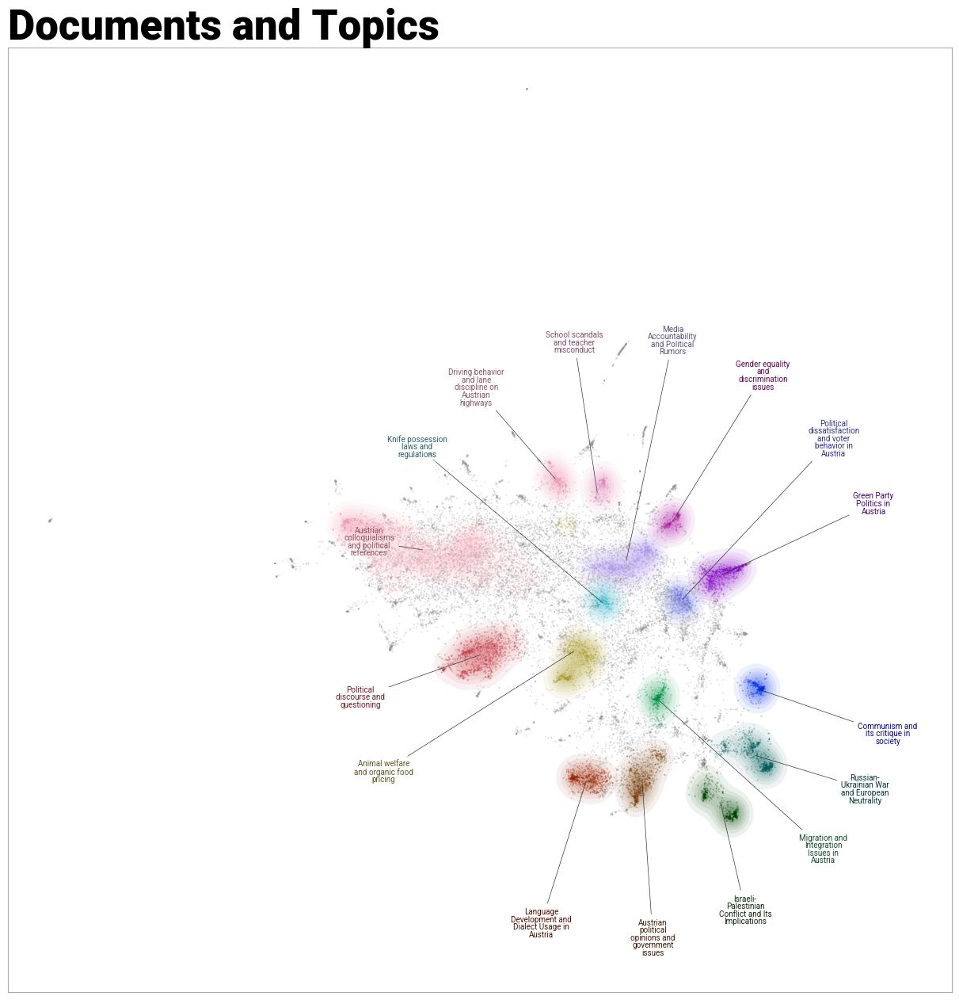

In [108]:
import itertools

datamap_before = topic_model_before.visualize_document_datamap(
    comments_before,
    reduced_embeddings=reduced_embeddings_before,
    #hide_annotations=True,
    #hide_document_hover=False,
    custom_labels=True,
)

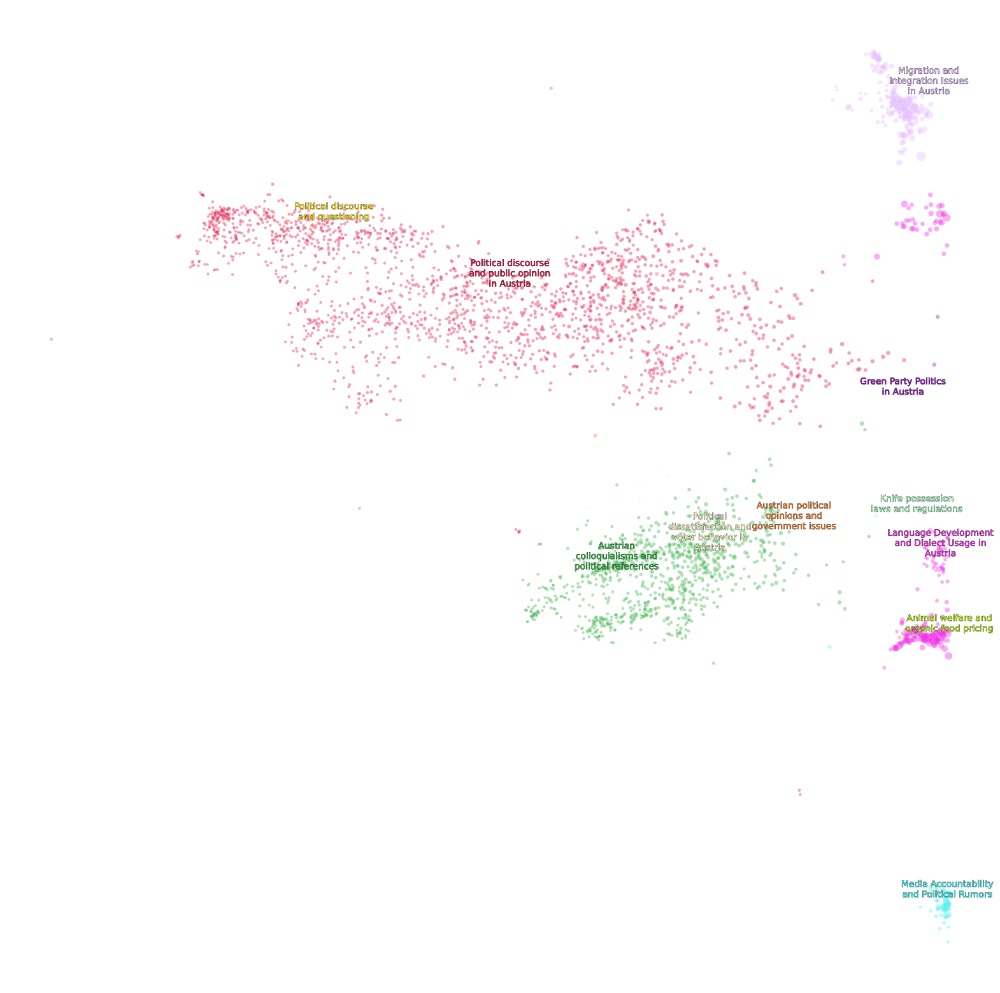

In [109]:
import seaborn as sns
from matplotlib import pyplot as plt
from adjustText import adjust_text
import matplotlib.patheffects as pe
import textwrap


colors = itertools.cycle(['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4', '#46f0f0', '#f032e6', '#bcf60c', '#fabebe', '#008080', '#e6beff', '#9a6324', '#fffac8', '#800000', '#aaffc3', '#808000', '#ffd8b1', '#000075', '#808080', '#ffffff', '#000000'])
color_key = {str(topic): next(colors) for topic in set(topic_model_before.topics_) if topic != -1}


df = pd.DataFrame({"x": reduced_embeddings_before[:, 0], "y": reduced_embeddings_before[:, 1], "Topic": [str(t) for t in topic_model_before.topics_]})
df["Length"] = [len(doc) for doc in comments_before]
df = df.loc[df.Topic != "-1"]
df = df.loc[(df.y > -10) & (df.y < 10) & (df.x < 10) & (df.x > -10), :]
df["Topic"] = df["Topic"].astype("category")


mean_df = df.groupby("Topic").mean().reset_index()
mean_df.Topic = mean_df.Topic.astype(int)
mean_df = mean_df.sort_values("Topic")


fig = plt.figure(figsize=(20, 20))
sns.scatterplot(
    data=df,
    x='x',
    y='y',
    hue='Topic',  
    palette=color_key, 
    alpha=0.4,
    size='Length', 
    sizes=(10, 200)
)


texts, xs, ys = [], [], []
for row in mean_df.iterrows():
  topic = row[1]["Topic"]
  name = textwrap.fill(topic_model_before.custom_labels_[int(topic)], 20)
  if int(topic) <= 20:
    xs.append(row[1]["x"])
    ys.append(row[1]["y"])
    texts.append(plt.text(row[1]["x"], row[1]["y"], name, size=10, ha="center", color=color_key[str(int(topic))],
                          path_effects=[pe.withStroke(linewidth=0.5, foreground="black")]
                          ))


adjust_text(texts, x=xs, y=ys, time_lim=1, force_text=(0.01, 0.02), force_static=(0.01, 0.02), force_pull=(0.5, 0.5))
plt.axis('off')
plt.legend('', frameon=False)
plt.show()

In [111]:
topic_model_after = BERTopic(

    # Sub-models.
    vectorizer_model=vectorizer_model,
    embedding_model=embedding_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    representation_model=representation_model,

    # Hyperparameters.
    top_n_words=10,
    verbose=True,
    language='german',
    calculate_probabilities=True,
)

In [114]:
topics, probs = topic_model_after.fit_transform(comments_after, embeddings_after)

2025-01-24 15:15:36,076 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm


2025-01-24 15:15:55,128 - BERTopic - Dimensionality - Completed ✓
2025-01-24 15:15:55,129 - BERTopic - Cluster - Start clustering the reduced embeddings
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid usi

In [115]:
topic_model_after.get_topic_info()

,Topic,Count,Name,Representation,GPT-4o-mini,Representative_Docs
0,-1,13111,-1_einfach_leute_geht_gut,"[einfach, leute, geht, gut, wäre, genau, wirkl...",[Political Landscape in Austria and Societal I...,[wie sind 2x mit dem nj wien - hamburg - wien ...
1,0,5158,0_gut_na_einfach_geht,"[gut, na, einfach, geht, genau, stimmt, oida, ...",[Casual conversation and agreement],"[ganz genau das, ja genau der!, gehen wohl net..."
2,1,1837,1_warum_frage_woher_wann,"[warum, frage, woher, wann, fpö, meinst, genau...",[Questions and Curiosities],"[wieso? würde mich echt interessieren warum., ..."
3,2,1797,2_österreich_deutschland_deutsche_österreicher,"[österreich, deutschland, deutsche, österreich...",[Austria and its comparison to Germany],[ist das besser oder schlechter als in österre...
4,3,1388,3_klima_klimawandel_klimaanlage_sommer,"[klima, klimawandel, klimaanlage, sommer, co2,...",[Climate change and its effects on summer heat...,"[niemand wird krank von einer klima....., mein..."
5,4,807,4_kaufen_preis_euro_billa,"[kaufen, preis, euro, billa, teller, amazon, e...",[Consumer Experiences with Local vs. Online Sh...,[die hauptargumentation bei vielen ist > man s...
6,5,775,5_lehrer_job_arbeiten_studium,"[lehrer, job, arbeiten, studium, netto, gehalt...",[Employment and income challenges in Austria],[sehe die fristen jetzt nicht unbedingt als ei...
7,6,771,6_partei_parteien_fpö_övp,"[partei, parteien, fpö, övp, wähler, wählen, p...",[Political polarization and party accountabili...,[die themen sind leider alle ausgeleiert oder ...
8,7,726,7_auto_fahren_radfahrer_autos,"[auto, fahren, radfahrer, autos, autofahrer, b...",[Traffic and Urban Mobility Issues],[kennst du den begriff der induzierten nachfra...
9,8,523,8_alkohol_bier_trinken_trinke,"[alkohol, bier, trinken, trinke, getrunken, tr...",[Social perceptions and personal choices regar...,[ich kenne das alles. ich habe im meinem leben...


In [118]:
gpt4omini_labels_after = [label[0][0].split("\n")[0] for label in topic_model_after.get_topics(full=True)["GPT-4o-mini"].values()]
topic_model_after.set_topic_labels(gpt4omini_labels_after)

In [120]:

for topic_id in topic_model_after.get_topic_info()['Topic']:
    if topic_id != -1: 

        topic_label = gpt4omini_labels_after[topic_id]
        

        keywords = topic_model_after.get_topic(topic_id)
        

        print(f"Topic {topic_id}: {topic_label}")
        for word, score in keywords:
            print(f"  {word:<15} ({score:.4f})")
        print("-" * 30) 

Topic 0: Political Landscape in Austria and Societal Issues
  gut             (0.0124)
  na              (0.0120)
  einfach         (0.0116)
  geht            (0.0112)
  genau           (0.0110)
  stimmt          (0.0110)
  oida            (0.0110)
  leider          (0.0106)
  ok              (0.0102)
  fpö             (0.0098)
------------------------------
Topic 1: Casual conversation and agreement
  warum           (0.0458)
  frage           (0.0192)
  woher           (0.0149)
  wann            (0.0135)
  fpö             (0.0132)
  meinst          (0.0129)
  genau           (0.0127)
  wos             (0.0120)
  fragen          (0.0118)
  vielleicht      (0.0114)
------------------------------
Topic 2: Questions and Curiosities
  österreich      (0.0685)
  deutschland     (0.0267)
  deutsche        (0.0235)
  österreicher    (0.0234)
  deutschen       (0.0232)
  austria         (0.0164)
  deutsch         (0.0144)
  österreichische (0.0128)
  land            (0.0114)
  einfach        

In [123]:
topic_model_after.visualize_documents(
    comments_after,
    reduced_embeddings=reduced_embeddings_after,
    hide_annotations=True,
    hide_document_hover=False,
    custom_labels=True
)

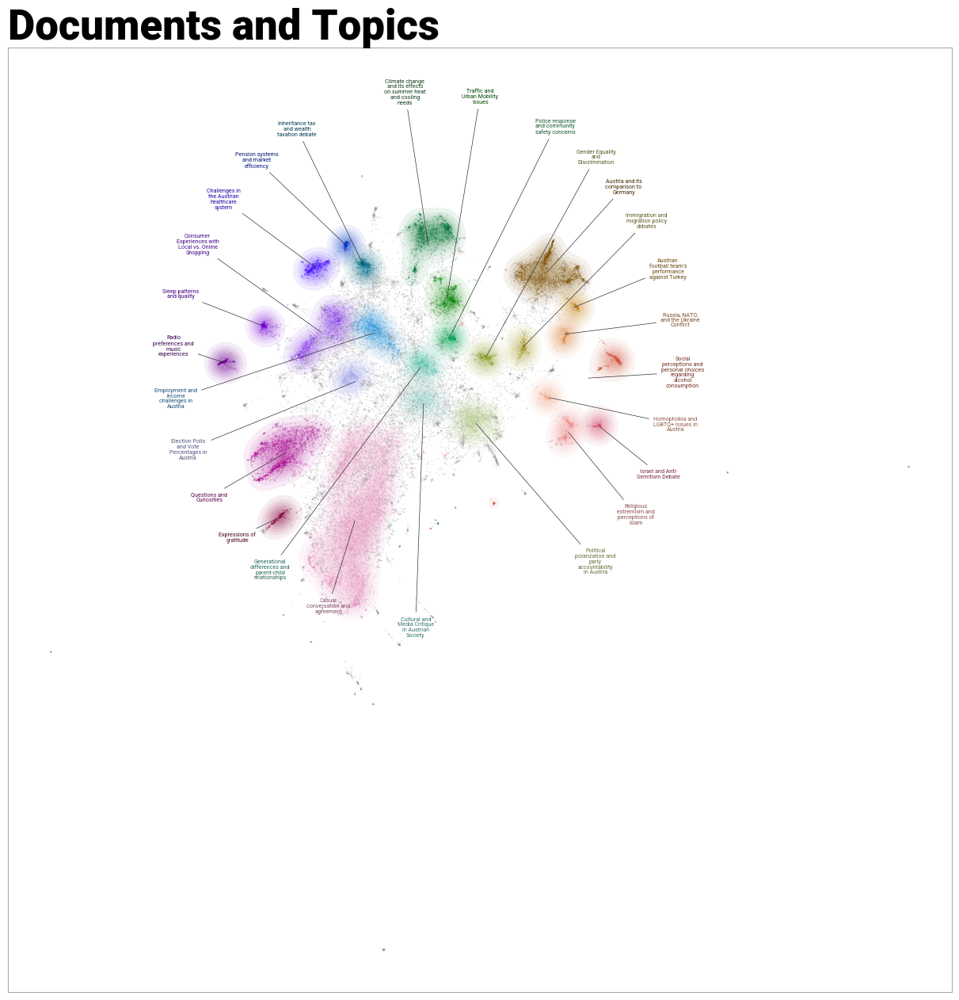

In [124]:
datamap_after = topic_model_after.visualize_document_datamap(
    comments_after,
    reduced_embeddings=reduced_embeddings_after,
    #hide_annotations=True,
    #hide_document_hover=False,
    custom_labels=True,
)

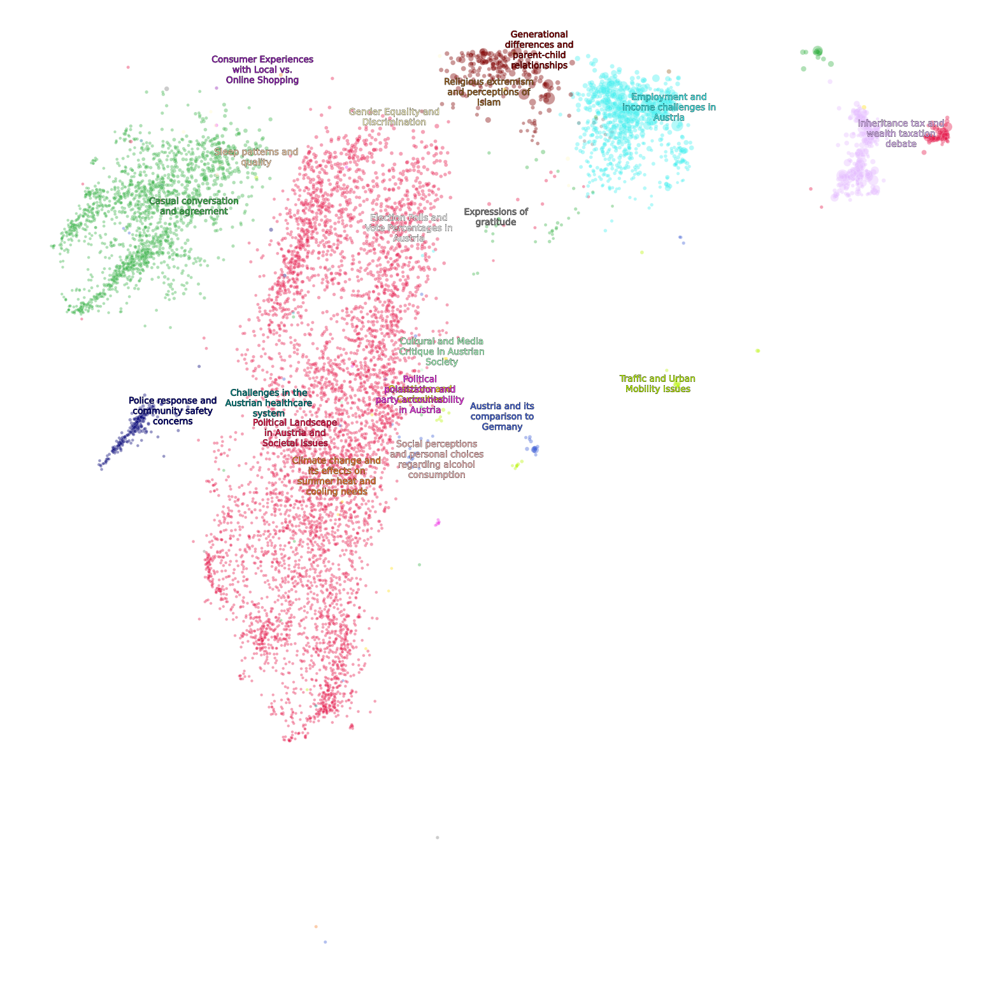

In [125]:
colors = itertools.cycle(['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4', '#46f0f0', '#f032e6', '#bcf60c', '#fabebe', '#008080', '#e6beff', '#9a6324', '#fffac8', '#800000', '#aaffc3', '#808000', '#ffd8b1', '#000075', '#808080', '#ffffff', '#000000'])
color_key = {str(topic): next(colors) for topic in set(topic_model_after.topics_) if topic != -1}

df = pd.DataFrame({"x": reduced_embeddings_after[:, 0], "y": reduced_embeddings_after[:, 1], "Topic": [str(t) for t in topic_model_after.topics_]})
df["Length"] = [len(doc) for doc in comments_after]
df = df.loc[df.Topic != "-1"]
df = df.loc[(df.y > -10) & (df.y < 10) & (df.x < 10) & (df.x > -10), :]
df["Topic"] = df["Topic"].astype("category")

mean_df = df.groupby("Topic").mean().reset_index()
mean_df.Topic = mean_df.Topic.astype(int)
mean_df = mean_df.sort_values("Topic")

fig = plt.figure(figsize=(20, 20))
sns.scatterplot(
    data=df,
    x='x',
    y='y',
    hue='Topic', 
    palette=color_key,  
    alpha=0.4,
    size='Length', 
    sizes=(10, 200)
)

texts, xs, ys = [], [], []
for row in mean_df.iterrows():
  topic = row[1]["Topic"]
  name = textwrap.fill(topic_model_after.custom_labels_[int(topic)], 20)
  if int(topic) <= 20:
    xs.append(row[1]["x"])
    ys.append(row[1]["y"])
    texts.append(plt.text(row[1]["x"], row[1]["y"], name, size=10, ha="center", color=color_key[str(int(topic))],
                          path_effects=[pe.withStroke(linewidth=0.5, foreground="black")]
                          ))

adjust_text(texts, x=xs, y=ys, time_lim=1, force_text=(0.01, 0.02), force_static=(0.01, 0.02), force_pull=(0.5, 0.5))
plt.axis('off')
plt.legend('', frameon=False)
plt.show()



## Adding topic descriptions

In [126]:
system_prompt_descriptions = """
<s>[INST] <<SYS>>
You are a helpful, respectful and honest assistant for generating descriptions about topics. You provide the descriptions in English, from text that is mostly written in Austrian German (keep in mind that the authors of the texts are Austrians and not Germans!). 
<</SYS>>
"""

main_prompt_descriptions = """
I have a topic that is described by the following keywords: [KEYWORDS]
In this topic, the following documents are a small but representative subset of all documents in the topic:
[DOCUMENTS]

Based on the information above, please give a description of this topic in the following format:
topic: <description>
"""

prompt_descriptions = system_prompt_descriptions + main_prompt_descriptions


gpt_4o_mini_label = OpenAI(client=client, model="gpt-4o-mini", prompt=prompt, chat=True)
gpt_4o_mini_description = OpenAI(client=client, model="gpt-4o-mini", prompt=prompt_descriptions, nr_docs=5, chat=True)

representation_model = {
    "GPT-4o-mini_label": gpt_4o_mini_label,
    "GPT-4o-mini_description": gpt_4o_mini_description
}

In [127]:
topic_model_before = BERTopic(

    # Sub-models.
    vectorizer_model=vectorizer_model,
    embedding_model=embedding_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    representation_model=representation_model,

    # Hyperparameters.
    top_n_words=10,
    verbose=True,
    language='german',
    calculate_probabilities=True,
)

In [128]:
topics, probs = topic_model_before.fit_transform(comments_before, embeddings_before)

2025-01-24 15:41:19,213 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-01-24 15:41:30,866 - BERTopic - Dimensionality - Completed ✓
2025-01-24 15:41:30,867 - BERTopic - Cluster - Start clustering the reduced embeddings
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been us

In [192]:
topic_model_before.get_topic_info()

,Topic,Count,Name,CustomName,Representation,GPT-4o-mini_label,GPT-4o-mini_description,Representative_Docs
0,-1,12181,-1_einfach_fpö_leute_geht,0: Political discourse and social issues in Au...,"[einfach, fpö, leute, geht, gut, viele, wirkli...",[Political discourse and social issues in Aust...,[The topic revolves around Austrian political ...,"[dass sich jemand weigert, über das asylsystem..."
1,0,2017,0_na_fpö_oida_lol,1: Austrian cultural expressions and humor,"[na, fpö, oida, lol, einfach, gut, kpö, di, ha...",[Austrian cultural expressions and humor],[This topic revolves around informal and humor...,"[oida!, na geh bitte, fpö]"
2,1,996,1_warum_meinst_wen_glaubst,2: Political Discussion and Clarification,"[warum, meinst, wen, glaubst, fpö, genau, würd...",[Political Discussion and Clarification],[The discussion revolves around political sent...,[ok? ähm ich verstehe was du meinst und stimme...
3,2,639,2_ukraine_russland_krieg_russen,3: Austria's Neutrality and the Ukraine-Russia...,"[ukraine, russland, krieg, russen, neutralität...",[Austria's Neutrality and the Ukraine-Russia C...,"[The conflict in Ukraine, stemming from Russia...",[das ist objektiv falsch. es hat ja schon vor ...
4,3,634,3_österreich_austria_österreicher_österreichische,4: Political opinions and governance in Austria,"[österreich, austria, österreicher, österreich...",[Political opinions and governance in Austria],[This topic revolves around Austria and its po...,"[das heißt trotzdem nicht, dass österreich nic..."
5,4,610,4_grünen_grün_schilling_grüne,5: Green Party Politics and Election Dynamics,"[grünen, grün, schilling, grüne, wählen, parte...",[Green Party Politics and Election Dynamics],[The discussion revolves around the political ...,[meine stimme haben die grünen verloren. ehrli...
6,5,606,5_journalisten_standard_schilling_gerüchte,6: Media and political discourse in Austria,"[journalisten, standard, schilling, gerüchte, ...",[Media and political discourse in Austria],[The topic revolves around the intricate relat...,[ich hab nur die infos welche in den zeitungen...
7,6,588,6_dialekt_deutsch_hochdeutsch_reden,7: Language and Dialect in Austria,"[dialekt, deutsch, hochdeutsch, reden, spreche...",[Language and Dialect in Austria],[The topic explores the dynamics of dialect an...,[man sollte keine ganze kultur opfern indem ma...
8,7,562,7_bio_fleisch_tierwohl_kaufen,8: Animal welfare and organic food purchasing ...,"[bio, fleisch, tierwohl, kaufen, tiere, ama, k...",[Animal welfare and organic food purchasing in...,[The discussion surrounding the consumption of...,[absolut. das hat aber nichts mit dem bio sieg...
9,8,473,8_israel_hamas_nazis_nazi,9: Israeli-Palestinian Conflict and Perspectives,"[israel, hamas, nazis, nazi, juden, palästinen...",[Israeli-Palestinian Conflict and Perspectives],[The topic revolves around the complex and con...,"[""autoritäres regime"", ich glaube nicht, dass ..."


In [ ]:
# Prepare data for the DataFrame, adjusting topic_id to start from 1.
topics_before_data = []

# Create a dictionary for labels to align topic_id and labels, starting from 1.
topic_label_mapping = {
    topic_id + 1: gpt4omini_labels_before[idx]
    for idx, topic_id in enumerate(topic_model_before.get_topic_info()['Topic'])
}

for topic_id in topic_model_before.get_topic_info()['Topic']:
    if topic_id != -1:  # Exclude the outlier topic (-1).
        # Adjust topic_id to start from 1.
        adjusted_topic_id = topic_id + 1

        # Fetch the label using the correct mapping.
        topic_label = topic_label_mapping.get(adjusted_topic_id, f"Unknown Topic {adjusted_topic_id}")

        # Get the description for the current topic.
        topic_description = topic_model_before.get_topic_info().loc[
            topic_model_before.get_topic_info()["Topic"] == topic_id, "GPT-4o-mini_description"
        ].values[0]
        
        # Ensure the description is handled correctly.
        if isinstance(topic_description, list):
            topic_description = topic_description[0]
        
        # Wrap the description for better formatting (optional).
        wrapped_description = "\n".join(textwrap.wrap(topic_description, width=80))
        
        # Get the top keywords for the topic.
        keywords = topic_model_before.get_topic(topic_id)
        keywords_str = ", ".join([f"{word} ({score:.4f})" for word, score in keywords])
        
        # Append the data.
        topics_before_data.append({
            "Topic_ID": adjusted_topic_id,
            "Label": topic_label,
            "Description": wrapped_description,
            "Top_Words": keywords_str
        })

# Create a DataFrame from the collected data.
df_topics_before = pd.DataFrame(topics_before_data)
df_topics_before = df_topics_before.reset_index(drop=True)

df_topics_before


,Topic_ID,Label,Description,Top_Words
0,1,Austrian colloquialisms and political references,This topic revolves around informal and humoro...,"na (0.0178), fpö (0.0174), oida (0.0170), lol ..."
1,2,Political discourse and questioning,The discussion revolves around political senti...,"warum (0.0289), meinst (0.0234), wen (0.0190),..."
2,3,Russian-Ukrainian War and European Neutrality,"The conflict in Ukraine, stemming from Russia'...","ukraine (0.0744), russland (0.0697), krieg (0...."
3,4,Austrian political opinions and government issues,This topic revolves around Austria and its pol...,"österreich (0.1256), austria (0.0476), österre..."
4,5,Green Party Politics in Austria,The discussion revolves around the political d...,"grünen (0.1325), grün (0.0494), schilling (0.0..."
5,6,Media Accountability and Political Rumors,The topic revolves around the intricate relati...,"journalisten (0.0233), standard (0.0200), schi..."
6,7,Language Development and Dialect Usage in Austria,The topic explores the dynamics of dialect and...,"dialekt (0.1045), deutsch (0.0545), hochdeutsc..."
7,8,Animal welfare and organic food pricing,The discussion surrounding the consumption of ...,"bio (0.0348), fleisch (0.0296), tierwohl (0.02..."
8,9,Israeli-Palestinian Conflict and Its Implications,The topic revolves around the complex and cont...,"israel (0.0625), hamas (0.0411), nazis (0.0389..."
9,10,Communism and its critique in society,The topic revolves around the concepts of comm...,"kommunismus (0.0811), kapitalismus (0.0469), s..."


In [215]:
# Save the DataFrame to an Excel file.
excel_file_path = "./artifacts/df_topics_before.xlsx"
df_topics_before.to_excel(excel_file_path, index=False)

In [201]:
# Create topic labels with topic_id included.
gpt4omini_before_labels = []
for topic_id, label in enumerate(topic_model_before.get_topics(full=True)["GPT-4o-mini_label"].values()):
    label_text = label[0][0].split("\n")[0]  # Extract the first line of the label
    gpt4omini_before_labels.append(f"{topic_id}: {label_text}")
topic_model_before.set_topic_labels(gpt4omini_before_labels)

In [202]:
topic_model_before.visualize_documents(
    comments_before,
    reduced_embeddings=reduced_embeddings_before,
    hide_annotations=True,
    hide_document_hover=False,
    custom_labels=True
)

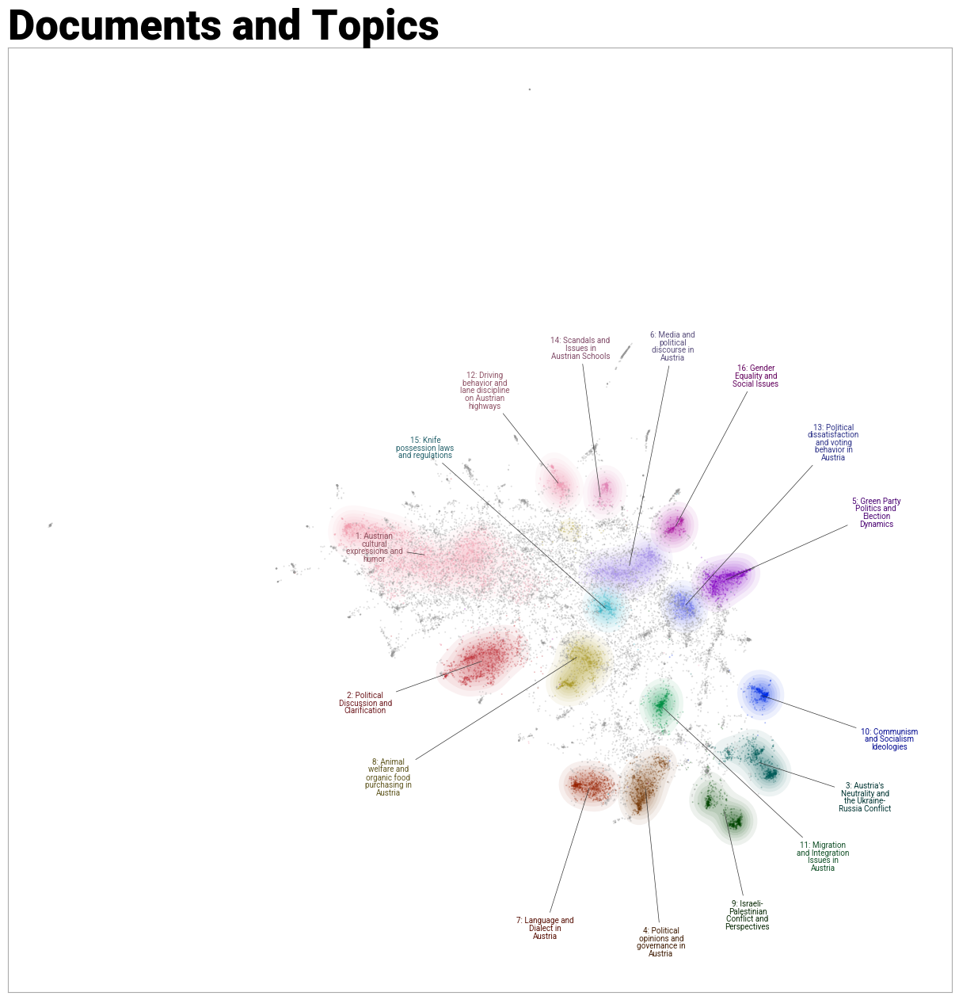

In [ ]:
datamap_before = topic_model_before.visualize_document_datamap(
    comments_before,
    reduced_embeddings=reduced_embeddings_before,
    #hide_annotations=True,
    #hide_document_hover=False,
    custom_labels=True,
)

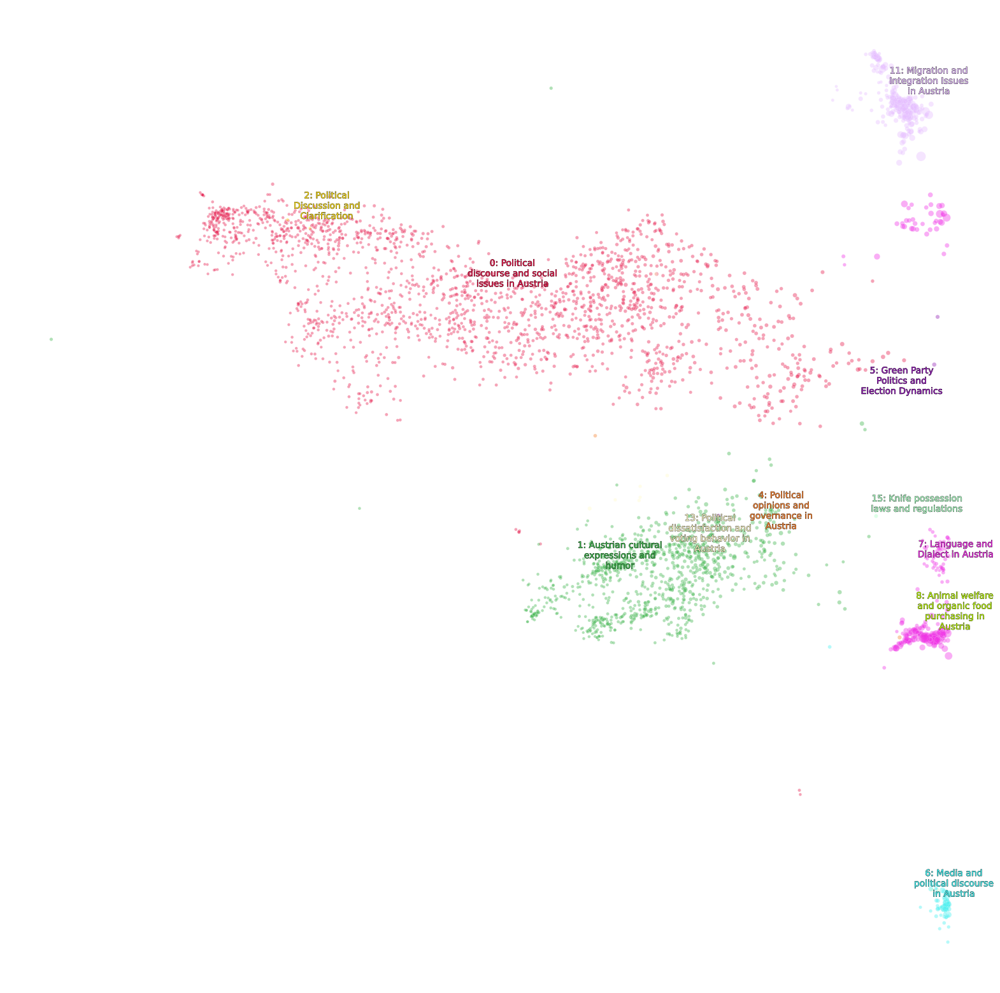

In [ ]:
colors = itertools.cycle(['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4', '#46f0f0', '#f032e6', '#bcf60c', '#fabebe', '#008080', '#e6beff', '#9a6324', '#fffac8', '#800000', '#aaffc3', '#808000', '#ffd8b1', '#000075', '#808080', '#ffffff', '#000000'])
color_key = {str(topic): next(colors) for topic in set(topic_model_before.topics_) if topic != -1}


df = pd.DataFrame({"x": reduced_embeddings_before[:, 0], "y": reduced_embeddings_before[:, 1], "Topic": [str(t) for t in topic_model_before.topics_]})
df["Length"] = [len(doc) for doc in comments_before]
df = df.loc[df.Topic != "-1"]
df = df.loc[(df.y > -10) & (df.y < 10) & (df.x < 10) & (df.x > -10), :]
df["Topic"] = df["Topic"].astype("category")


mean_df = df.groupby("Topic").mean().reset_index()
mean_df.Topic = mean_df.Topic.astype(int)
mean_df = mean_df.sort_values("Topic")


fig = plt.figure(figsize=(20, 20))
sns.scatterplot(
    data=df,
    x='x',
    y='y',
    hue='Topic', 
    palette=color_key,  
    alpha=0.4,
    size='Length',  
    sizes=(10, 200)
)


texts, xs, ys = [], [], []
for row in mean_df.iterrows():
  topic = row[1]["Topic"]
  name = textwrap.fill(topic_model_before.custom_labels_[int(topic)], 20)
  if int(topic) <= 20:
    xs.append(row[1]["x"])
    ys.append(row[1]["y"])
    texts.append(plt.text(row[1]["x"], row[1]["y"], name, size=10, ha="center", color=color_key[str(int(topic))],
                          path_effects=[pe.withStroke(linewidth=0.5, foreground="black")]
                          ))


adjust_text(texts, x=xs, y=ys, time_lim=1, force_text=(0.01, 0.02), force_static=(0.01, 0.02), force_pull=(0.5, 0.5))
plt.axis('off')
plt.legend('', frameon=False)
plt.show()

In [177]:
topic_model_after = BERTopic(

    # Sub-models.
    vectorizer_model=vectorizer_model,
    embedding_model=embedding_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    representation_model=representation_model,

    # Hyperparameters.
    top_n_words=10,
    verbose=True,
    language='german',
    calculate_probabilities=True,
)

In [178]:
topics, probs = topic_model_after.fit_transform(comments_after, embeddings_after)

2025-01-24 16:44:04,248 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-01-24 16:44:22,264 - BERTopic - Dimensionality - Completed ✓
2025-01-24 16:44:22,265 - BERTopic - Cluster - Start clustering the reduced embeddings
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been us

In [179]:
topic_model_after.get_topic_info()

,Topic,Count,Name,Representation,GPT-4o-mini_label,GPT-4o-mini_description,Representative_Docs
0,-1,13111,-1_einfach_leute_geht_gut,"[einfach, leute, geht, gut, wäre, genau, wirkl...",[Political Landscape and Social Issues in Aust...,[This topic revolves around the challenges fac...,[wie sind 2x mit dem nj wien - hamburg - wien ...
1,0,5158,0_gut_na_einfach_geht,"[gut, na, einfach, geht, genau, stimmt, oida, ...",[Casual conversation and expressions in Austri...,[This topic revolves around discussions and op...,"[ganz genau das, ja genau der!, gehen wohl net..."
2,1,1837,1_warum_frage_woher_wann,"[warum, frage, woher, wann, fpö, meinst, genau...",[Questions and Confusion],[This topic revolves around a series of provoc...,"[wieso? würde mich echt interessieren warum., ..."
3,2,1797,2_österreich_deutschland_deutsche_österreicher,"[österreich, deutschland, deutsche, österreich...",[Austria and its culture],[The topic revolves around the cultural and so...,[ist das besser oder schlechter als in österre...
4,3,1388,3_klima_klimawandel_klimaanlage_sommer,"[klima, klimawandel, klimaanlage, sommer, co2,...",[Climate change and its effects on summer heat],[The discussion around climate and climate cha...,"[niemand wird krank von einer klima....., mein..."
5,4,807,4_kaufen_preis_euro_billa,"[kaufen, preis, euro, billa, teller, amazon, e...",[Shopping and pricing experiences in Austria],[This topic revolves around the dynamics of co...,[die hauptargumentation bei vielen ist > man s...
6,5,775,5_lehrer_job_arbeiten_studium,"[lehrer, job, arbeiten, studium, netto, gehalt...","[Employment, Salaries, and Job Conditions]",[This topic revolves around the employment exp...,[sehe die fristen jetzt nicht unbedingt als ei...
7,6,771,6_partei_parteien_fpö_övp,"[partei, parteien, fpö, övp, wähler, wählen, p...",[Political Polarization and Democracy in Austria],[The discussion revolves around the political ...,[die themen sind leider alle ausgeleiert oder ...
8,7,726,7_auto_fahren_radfahrer_autos,"[auto, fahren, radfahrer, autos, autofahrer, b...",[Traffic and Urban Mobility Issues],[The intersection of various modes of transpor...,[kennst du den begriff der induzierten nachfra...
9,8,523,8_alkohol_bier_trinken_trinke,"[alkohol, bier, trinken, trinke, getrunken, tr...",[Social perceptions and habits regarding alcoh...,[The topic revolves around the cultural and pe...,[ich kenne das alles. ich habe im meinem leben...


In [ ]:
topics_after_data = []

topic_label_mapping = {
    topic_id + 1: gpt4omini_labels_after[idx]
    for idx, topic_id in enumerate(topic_model_after.get_topic_info()['Topic'])
}

for topic_id in topic_model_after.get_topic_info()['Topic']:
    if topic_id != -1:  
        adjusted_topic_id = topic_id + 1

        topic_label = topic_label_mapping.get(adjusted_topic_id, f"Unknown Topic {adjusted_topic_id}")

        topic_description = topic_model_after.get_topic_info().loc[
            topic_model_after.get_topic_info()["Topic"] == topic_id, "GPT-4o-mini_description"
        ].values[0]
        
        if isinstance(topic_description, list):
            topic_description = topic_description[0]
        
        wrapped_description = "\n".join(textwrap.wrap(topic_description, width=80))
        
        keywords = topic_model_after.get_topic(topic_id)
        keywords_str = ", ".join([f"{word} ({score:.4f})" for word, score in keywords])
        
        topics_after_data.append({
            "Topic_ID": adjusted_topic_id,
            "Label": topic_label,
            "Description": wrapped_description,
            "Top_Words": keywords_str
        })

df_topics_after = pd.DataFrame(topics_after_data)
df_topics_after = df_topics_after.reset_index(drop=True)

df_topics_after

,Topic_ID,Label,Description,Top_Words
0,1,Casual conversation and agreement,This topic revolves around discussions and opi...,"gut (0.0124), na (0.0120), einfach (0.0116), g..."
1,2,Questions and Curiosities,This topic revolves around a series of provoca...,"warum (0.0458), frage (0.0192), woher (0.0149)..."
2,3,Austria and its comparison to Germany,The topic revolves around the cultural and soc...,"österreich (0.0685), deutschland (0.0267), deu..."
3,4,Climate change and its effects on summer heat ...,The discussion around climate and climate chan...,"klima (0.0266), klimawandel (0.0236), klimaanl..."
4,5,Consumer Experiences with Local vs. Online Sho...,This topic revolves around the dynamics of con...,"kaufen (0.0206), preis (0.0198), euro (0.0190)..."
5,6,Employment and income challenges in Austria,This topic revolves around the employment expe...,"lehrer (0.0215), job (0.0199), arbeiten (0.018..."
6,7,Political polarization and party accountabilit...,The discussion revolves around the political l...,"partei (0.0441), parteien (0.0360), fpö (0.034..."
7,8,Traffic and Urban Mobility Issues,The intersection of various modes of transport...,"auto (0.0579), fahren (0.0357), radfahrer (0.0..."
8,9,Social perceptions and personal choices regard...,The topic revolves around the cultural and per...,"alkohol (0.0933), bier (0.0585), trinken (0.04..."
9,10,Challenges in the Austrian healthcare system,The topic addresses the challenges and complex...,"termin (0.0302), krankenhaus (0.0281), patient..."


In [212]:
excel_file_path = "./artifacts/df_topics_after.xlsx"
df_topics_after.to_excel(excel_file_path, index=False)

In [185]:
gpt4omini_after_labels = []
for topic_id, label in enumerate(topic_model_after.get_topics(full=True)["GPT-4o-mini_label"].values()):
    label_text = label[0][0].split("\n")[0]
    gpt4omini_after_labels.append(f"{topic_id}: {label_text}")
topic_model_after.set_topic_labels(gpt4omini_after_labels)

In [188]:
topic_model_after.visualize_documents(
    comments_after,
    reduced_embeddings=reduced_embeddings_after,
    hide_annotations=True,
    hide_document_hover=False,
    custom_labels=True
)

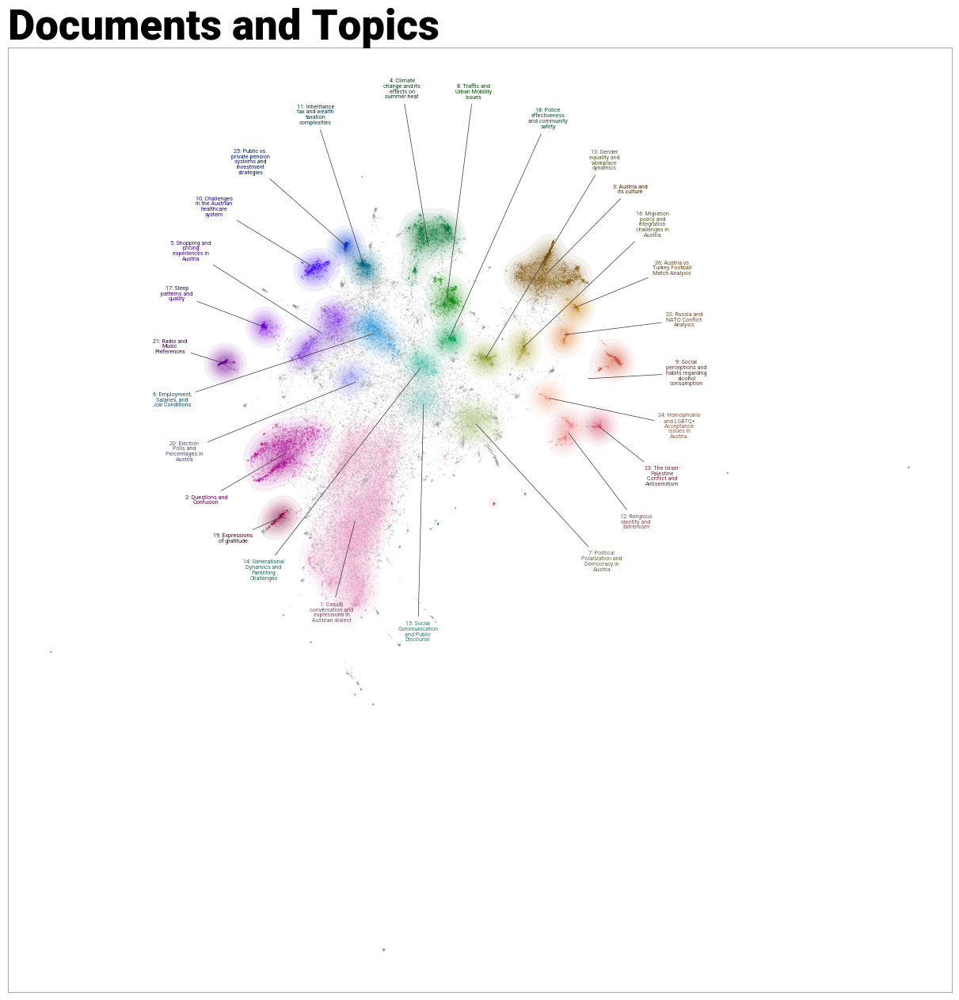

In [189]:
datamap_before = topic_model_after.visualize_document_datamap(
    comments_after,
    reduced_embeddings=reduced_embeddings_after,
    #hide_annotations=True,
    #hide_document_hover=False,
    custom_labels=True,
)

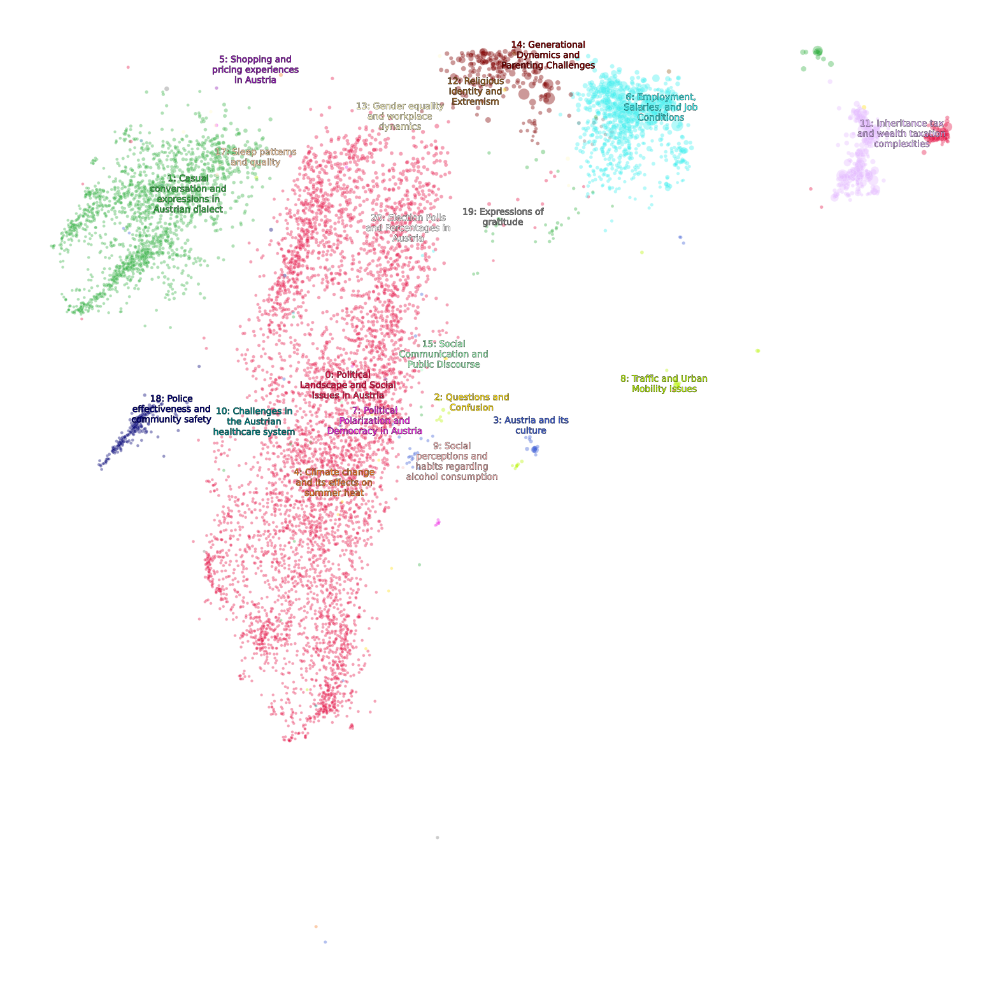

In [190]:
colors = itertools.cycle(['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4', '#46f0f0', '#f032e6', '#bcf60c', '#fabebe', '#008080', '#e6beff', '#9a6324', '#fffac8', '#800000', '#aaffc3', '#808000', '#ffd8b1', '#000075', '#808080', '#ffffff', '#000000'])
color_key = {str(topic): next(colors) for topic in set(topic_model_after.topics_) if topic != -1}


df = pd.DataFrame({"x": reduced_embeddings_after[:, 0], "y": reduced_embeddings_after[:, 1], "Topic": [str(t) for t in topic_model_after.topics_]})
df["Length"] = [len(doc) for doc in comments_after]
df = df.loc[df.Topic != "-1"]
df = df.loc[(df.y > -10) & (df.y < 10) & (df.x < 10) & (df.x > -10), :]
df["Topic"] = df["Topic"].astype("category")


mean_df = df.groupby("Topic").mean().reset_index()
mean_df.Topic = mean_df.Topic.astype(int)
mean_df = mean_df.sort_values("Topic")

fig = plt.figure(figsize=(20, 20))
sns.scatterplot(
    data=df,
    x='x',
    y='y',
    hue='Topic',  
    palette=color_key,  
    alpha=0.4,
    size='Length',  
    sizes=(10, 200)
)


texts, xs, ys = [], [], []
for row in mean_df.iterrows():
  topic = row[1]["Topic"]
  name = textwrap.fill(topic_model_after.custom_labels_[int(topic)], 20)
  if int(topic) <= 20:
    xs.append(row[1]["x"])
    ys.append(row[1]["y"])
    texts.append(plt.text(row[1]["x"], row[1]["y"], name, size=10, ha="center", color=color_key[str(int(topic))],
                          path_effects=[pe.withStroke(linewidth=0.5, foreground="black")]
                          ))

adjust_text(texts, x=xs, y=ys, time_lim=1, force_text=(0.01, 0.02), force_static=(0.01, 0.02), force_pull=(0.5, 0.5))
plt.axis('off')
plt.legend('', frameon=False)
plt.show()

# Interpreting the results

If we first focus on the interpretation of the topic modeling results for the period before the elections, one of them is close to topic number 13 (Political dissatisfaction and voting behavior in Austria) and number 5 (Green Party Politics and Election Dynamics). When reading the description for topic 5, which touches on the politics of the Greens (Die Grünen), we find that the comment authors clearly expressed a high degree of negative sentiment toward them. The main reasons for this were dissatisfaction with the party leaders and candidates such as Lena Schilling. Both topics also reflect a broader trend present in both topic groups, which supports the fact that the scope of the elections for Austria was not just Europe, but also an important test of (in)power on the domestic political stage.

Close to these two groups is also topic number 6, which concerns the media and political discourse within the country. Reading the description here also adds more nuance to the otherwise generalized description – once again, the focus was on the then-main candidate of the Austrian Greens, Schilling, who at that time was the target of public accusations due to several instances of distortion of truth. Upon further investigation, we found that the basis for this were her fabricated claims about a scandal involving a journalist (https://www.welt.de/politik/ausland/article252489580/Oesterreich-Gruenen-Politikerin-erfand-Affaere-mit-Journalist.html) and lies about violence (https://www.politico.eu/article/austria-greens-eu-election-2024-lena-schilling-affair/). We leave aside the debate on how much private images of party leaders should influence the evaluation of party programs, but through this we see the usefulness of tools like BERTopic for detecting sensitive points in discourse (such as Schilling in this case), which would be much harder to discover through manual reading of comments. In this respect, BERTopic offers the functionality to probe through a selected text corpus — from seemingly scattered text fragments, it weaves an understandable picture of the main areas of activity, which can then be further explored based on interest.

Besides linking topics in depth, some topics can also be grouped under broader labels. Such are, for example, topics of the Israeli-Palestinian conflict (no. 9), migration and integration issues (no. 11), and political opinions and governance (no. 4), all of which can be connected to broader human questions of identity seeking and community building.

The view of the post-election period shows an expected picture regarding the public sentiment after the elections, which fluctuates between the joy of those satisfied with the results (topic no. 19: Expressions of gratitude) and a larger group of those who are not (topic no. 2: Questions and Confusion). There also appear clusters of topics related to reforms (no. 11: Inheritance tax and wealth taxation complexities, no. 25: Public vs. private pension systems and investment strategies, no. 10: Challenges in the Austrian health care system).

As was the case before the elections, topics related to gender equality (no. 13) and groups that could again be classified under the realm of personal identity (nos. 24, 23, and 12) are represented among the topics.

In both periods, before and after the elections, the largest clusters belong to topics of collegial, lighter conversations, which is not surprising given the nature of the online platform from which the data originate. Accompanying them in both cases are politically charged clusters — in the pre-election period, a close cluster explicitly includes the phrase “political discourse” in its name, while similarly telling is the point cloud of the post-election period, representing public discourse and accompanied by the theme of political polarization. Both express the significant role that online platforms can have in shaping the political will of the masses.

Dividing the data into two parts has proven to be a useful tool for interpreting the data, as it reduces the dimensionality of the overall data set and makes it clearer where there are matches or mismatches between the periods. If the same representation were used on the combined data set, we would lose part of the temporal component, which is at least somewhat present in this case. To accurately track the trend of topic frequencies, however, we still had to resort to a representation more closely tied to time, which is shown below.

# Displaying topics over time

In [ ]:
# Use the entire dataset for comments.
comments = df_full['Comment'].to_list()

# Precalculate embeddings for all comments.
embeddings = embedding_model.encode(comments, show_progress_bar=True)

umap_model = UMAP(
    n_neighbors=15,
    n_components=5,
    min_dist=0.0,
    metric='cosine',
    random_state=42
)

hdbscan_model = HDBSCAN(
    min_cluster_size=150,
    metric='euclidean',
    cluster_selection_method='eom',
    prediction_data=True
)

topic_model = BERTopic(
    vectorizer_model=vectorizer_model,
    embedding_model=embedding_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    representation_model=representation_model,
    top_n_words=10,
    verbose=True,
    language='german',
    calculate_probabilities=True,
)

Batches:   0%|          | 0/1648 [00:00<?, ?it/s]

In [252]:
topics, probs = topic_model.fit_transform(comments, embeddings)

2025-01-24 18:46:19,727 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-01-24 18:46:51,250 - BERTopic - Dimensionality - Completed ✓
2025-01-24 18:46:51,261 - BERTopic - Cluster - Start clustering the reduced embeddings
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been us

In [256]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,GPT-4o-mini_label,GPT-4o-mini_description,Representative_Docs
0,-1,26839,-1_einfach_leute_gut_geht,"[einfach, leute, gut, geht, wirklich, fpö, gen...",[Austrian political discourse and social attit...,[This topic revolves around the complexities o...,"[ich find solche threads so unnedig, sorry, es..."
1,0,3751,0_na_oida_fpö_geht,"[na, oida, fpö, geht, gut, kpö, lol, genau, ei...",[Austrian colloquial expressions and political...,[This topic revolves around various aspects of...,"[ja, geht so, eher ja, geht so, oida wtf, na d..."
2,1,2816,1_warum_meinst_genau_woher,"[warum, meinst, genau, woher, frage, wann, gla...",[Questions and Doubts],[This topic revolves around questions and disc...,[warum muss ich jetzt nur daran denken...\n\n\...
3,2,1619,2_österreich_austria_österreicher_österreichische,"[österreich, austria, österreicher, österreich...",[Austrian identity and politics],[This topic revolves around Austria (Österreic...,[ist das besser oder schlechter als in österre...
4,3,1427,3_klima_klimawandel_co2_sommer,"[klima, klimawandel, co2, sommer, klimaanlage,...",[Climate Change and Its Effects],[The ongoing discourse on climate change highl...,[die klima verwendet energie um warme luft von...
5,4,1111,4_auto_fahren_radfahrer_autos,"[auto, fahren, radfahrer, autos, spur, autofah...",[Traffic and Mobility Issues in Urban Environm...,[The topic revolves around the complexities an...,[dann bleibt man am besten gleich aus sicherhe...
6,5,1076,5_dialekt_deutsch_deutschen_deutsche,"[dialekt, deutsch, deutschen, deutsche, hochde...",[Language and Dialect in Austrian Culture],[The topic discusses the interplay between dia...,[sieh den dialekt einfach wie eine andere spra...
7,6,1006,6_partei_fpö_wählen_parteien,"[partei, fpö, wählen, parteien, wähler, politi...",[Political dissatisfaction and electoral behav...,[The political landscape in Austria is current...,"[ich denk es mir auch die ganze zeit, dass so ..."
8,7,930,7_grünen_grün_schilling_grüne,"[grünen, grün, schilling, grüne, wählen, parte...",[Critique of the Green Party in Austria],[The topic revolves around the political lands...,"[den grünen anscheinend schon., so geht’s mir ..."
9,8,743,8_online_amazon_kaufen_euro,"[online, amazon, kaufen, euro, preis, preise, ...",[Shopping habits and price comparisons between...,[The discussion revolves around the dynamics o...,"[ich versuche, möglichst lokal zu kaufen, aber..."


In [259]:
# Generate the topics over time DataFrame.
topics_over_time = topic_model.topics_over_time(
    docs=df_full['Comment'].tolist(),
    timestamps=df_full['Timestamp'],
    nr_bins=20 # Split time range into 20 equal intervals.
)

20it [00:06,  3.11it/s]


In [274]:
topic_model.visualize_topics_over_time(topics_over_time=topics_over_time, topics=[0, 1, 2, 3, 6, 7], custom_labels=True)

The above graph `*` nicely demonstrates that the movement of public sentiment aligns with the election cycle. We selected most of the topics for display because they are politically charged, and we see that they roughly follow the same trend. As an exception, we included the most viral topic of all (orange line), since it provides a reference point based on which it is easier to assess the uniqueness of the frequency of others. If we disregard the far-right peak (due to a disproportionate increase in frequency, we suspect this is an "artificial" influence from one of the indirect factors, such as a change in data access, although we did not verify this), we see that there are three frequency spikes — the central one coincides with the election period (June 6–9), while the first may be related to leadership changes in three of the most popular Austrian parties (https://blogs.lse.ac.uk/europpblog/2024/05/07/austria-the-2024-european-parliament-elections-a-prelude-to-this-years-legislative-elections/). Regarding the third frequency increase, visible in early July, we were unable to find information indicating anything special happening in the Austrian political scene at that time, but it is possible that the rise in the number of comments during this period was of a general nature, due to major social events taking place in the summer (such as the Bregenz Music Festival). Supporting this interpretation is also the greater deviation of the orange line away from the others during this period.

`*` If the graph isn't rendered properly I encourage the reader to access the image of it directly via supplementary_materials/topics_over_time.png

# Conclusion

With our approach to topic modeling of data, we aimed to demonstrate the usefulness of this tool for interpreting social phenomena. Especially in combination with contextually enriched representations of large language models, BERTopic proves to be a powerful Swiss army knife when dealing with unpredictable material such as the content of comments on the popular online platform Reddit.
LLMs helped us overcome the challenge of not understanding the language in which most of the analyzed text was written. Something that would sometimes require additional complication of the data preprocessing process could now be solved on the fly, simply by providing the model with a precisely formulated prompt.